# Exploratory Data Analysis on the KiBA benchmark dataset
By Carlo Grigioni, Christian Pala and Andrea Wey

### Libraries

In [1]:
from DeepPurpose.dataset import load_process_KIBA
import pandas as pd
import matplotlib.pyplot as plt
from rdkit import Chem
import mols2grid

### Load and process the dataset
Note: we do not perform EDA on DAVIS, since it's a very small dataset.

In [2]:
X_drugs_kiba, X_targets_kiba, y_kiba = load_process_KIBA(path = './data', binary = False, threshold = 30)

Beginning Processing...
Beginning to extract zip file...
Done!


In [3]:
len(X_drugs_kiba), len(X_targets_kiba), len(y_kiba)

(118254, 118254, 118254)

The dataset has three features, drug ligands canonical SMILES, target protein sequences and binding affinity.

In [11]:
X_drugs_kiba = pd.DataFrame(X_drugs_kiba)
X_targets_kiba = pd.DataFrame(X_targets_kiba)
y_kiba = pd.DataFrame(y_kiba)

In [5]:
X_drugs_kiba.head()

,0
0,COC1=C(C=C2C(=C1)CCN=C2C3=CC(=C(C=C3)Cl)Cl)Cl
1,COC1=C(C=C2C(=C1)CCN=C2C3=CC(=C(C=C3)Cl)Cl)Cl
2,COC1=C(C=C2C(=C1)CCN=C2C3=CC(=C(C=C3)Cl)Cl)Cl
3,COC1=C(C=C2C(=C1)CCN=C2C3=CC(=C(C=C3)Cl)Cl)Cl
4,COC1=C(C=C2C(=C1)CCN=C2C3=CC(=C(C=C3)Cl)Cl)Cl


In [6]:
X_drugs_kiba.describe()

,0
count,118254
unique,2068
top,CN1CCN(CC1)C2=CC=C(C=C2)C(=O)NC3=NNC4=C3CN(C4)...
freq,184


In [7]:
X_drugs_kiba.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118254 entries, 0 to 118253
Data columns (total 1 columns):
 #   Column  Non-Null Count   Dtype 
---  ------  --------------   ----- 
 0   0       118254 non-null  object
dtypes: object(1)
memory usage: 924.0+ KB


Checking for missing values

In [12]:
X_drugs_kiba.isnull().sum(), X_targets_kiba.isnull().sum(), y_kiba.isnull().sum()

(0    0
 dtype: int64,
 0    0
 dtype: int64,
 0    0
 dtype: int64)

As expected from a benchmark dataset, there are no missing values.

In [13]:
X_drugs_kiba['Length'] = X_drugs_kiba[0].str.len()

In [14]:
X_drugs_kiba.head()

,0,Length
0,COC1=C(C=C2C(=C1)CCN=C2C3=CC(=C(C=C3)Cl)Cl)Cl,45
1,COC1=C(C=C2C(=C1)CCN=C2C3=CC(=C(C=C3)Cl)Cl)Cl,45
2,COC1=C(C=C2C(=C1)CCN=C2C3=CC(=C(C=C3)Cl)Cl)Cl,45
3,COC1=C(C=C2C(=C1)CCN=C2C3=CC(=C(C=C3)Cl)Cl)Cl,45
4,COC1=C(C=C2C(=C1)CCN=C2C3=CC(=C(C=C3)Cl)Cl)Cl,45


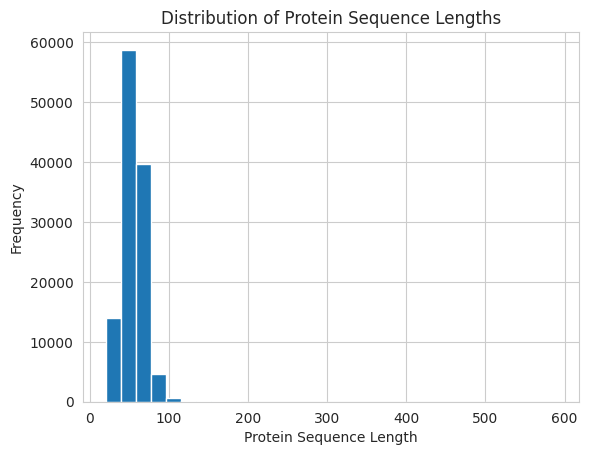

In [15]:
plt.hist(X_drugs_kiba['Length'], bins=30)
plt.xlabel('Protein Sequence Length')
plt.ylabel('Frequency')
plt.title('Distribution of Protein Sequence Lengths')
plt.show()

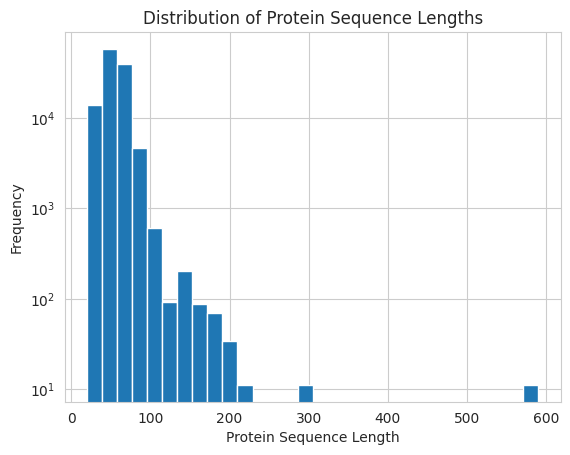

In [16]:
plt.hist(X_drugs_kiba['Length'], bins=30, log=True)
plt.xlabel('Protein Sequence Length')
plt.ylabel('Frequency')
plt.title('Distribution of Protein Sequence Lengths')
plt.show()

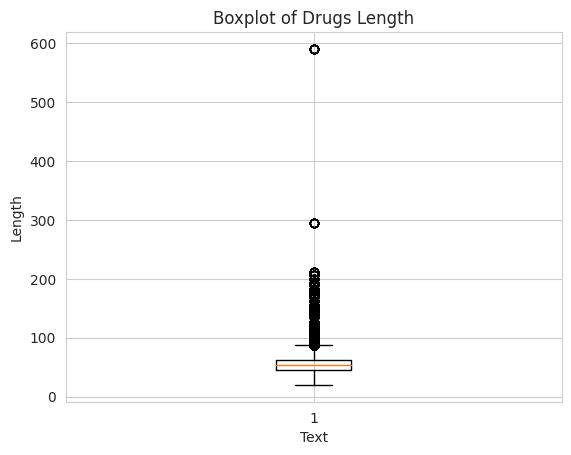

In [17]:
plt.boxplot(X_drugs_kiba['Length'])

# Set the plot title and axis labels
plt.title('Boxplot of Drugs Length')
plt.xlabel('Text')
plt.ylabel('Length')

# Show the plot
plt.show()

In [18]:
X_targets_kiba = pd.DataFrame(X_targets_kiba)

In [19]:
X_targets_kiba.head()

,0
0,MTVKTEAAKGTLTYSRMRGMVAILIAFMKQRRMGLNDFIQKIANNS...
1,MSWSPSLTTQTCGAWEMKERLGTGGFGNVIRWHNQETGEQIAIKQC...
2,MERPPGLRPGAGGPWEMRERLGTGGFGNVCLYQHRELDLKIAIKSC...
3,MRPSGTAGAALLALLAALCPASRALEEKKVCQGTSNKLTQLGTFED...
4,MELAALCRWGLLLALLPPGAASTQVCTGTDMKLRLPASPETHLDML...


In [20]:
X_targets_kiba.describe()

,0
count,118254
unique,229
top,MQSKVLLAVALWLCVETRAASVGLPSVSLDLPRLSIQKDILTIKAN...
freq,1452


In [21]:
X_targets_kiba.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118254 entries, 0 to 118253
Data columns (total 1 columns):
 #   Column  Non-Null Count   Dtype 
---  ------  --------------   ----- 
 0   0       118254 non-null  object
dtypes: object(1)
memory usage: 924.0+ KB


In [22]:
X_targets_kiba['Length'] = X_targets_kiba[0].str.len()

In [23]:
X_targets_kiba.head()

,0,Length
0,MTVKTEAAKGTLTYSRMRGMVAILIAFMKQRRMGLNDFIQKIANNS...,431
1,MSWSPSLTTQTCGAWEMKERLGTGGFGNVIRWHNQETGEQIAIKQC...,756
2,MERPPGLRPGAGGPWEMRERLGTGGFGNVCLYQHRELDLKIAIKSC...,745
3,MRPSGTAGAALLALLAALCPASRALEEKKVCQGTSNKLTQLGTFED...,1210
4,MELAALCRWGLLLALLPPGAASTQVCTGTDMKLRLPASPETHLDML...,1255


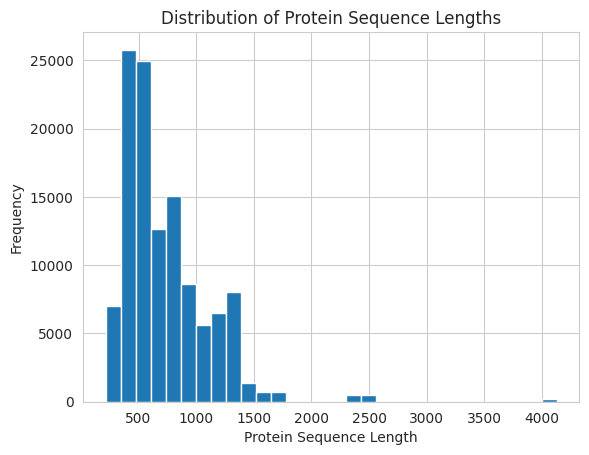

In [24]:
plt.hist(X_targets_kiba['Length'], bins=30)
plt.xlabel('Protein Sequence Length')
plt.ylabel('Frequency')
plt.title('Distribution of Protein Sequence Lengths')
plt.show()

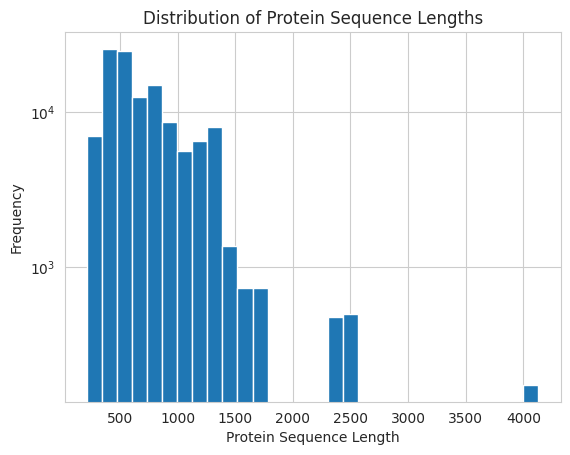

In [25]:
plt.hist(X_targets_kiba['Length'], bins=30, log=True)
plt.xlabel('Protein Sequence Length')
plt.ylabel('Frequency')
plt.title('Distribution of Protein Sequence Lengths')
plt.show()

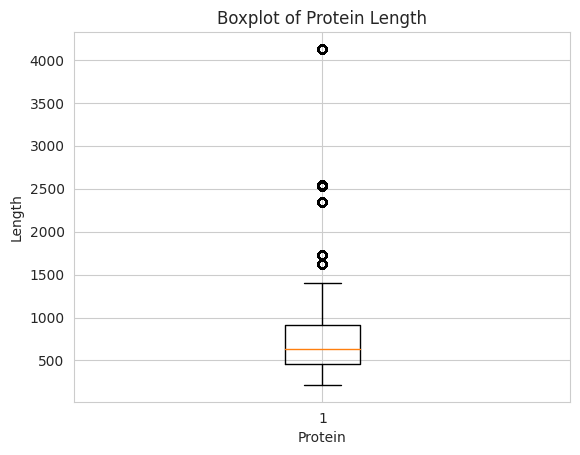

In [27]:
plt.boxplot(X_targets_kiba['Length'])

# Set the plot title and axis labels
plt.title('Boxplot of Protein Length')
plt.xlabel('Protein')
plt.ylabel('Length')

# Show the plot
plt.show()

The applicability domain of models trained on Kiba is for proteins of length below ~ 1400, since most of the proteins in the dataset, excluding likely outliers, have shorter sequences.

In [28]:
quantile_95 = X_targets_kiba['Length'].quantile(q=0.95)
quantile_95

1367.0

In [29]:
y_kiba = pd.DataFrame(y_kiba)

In [30]:
y_kiba.head()

,0
0,11.1
1,11.1
2,11.1
3,11.1
4,11.1


In [31]:
y_kiba.describe()

,0
count,118254.000000
mean,11.719935
std,0.836947
min,0.000000
25%,11.200000
50%,11.500000
75%,11.923909
max,17.200179


In [32]:
y_kiba.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118254 entries, 0 to 118253
Data columns (total 1 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   0       118254 non-null  float64
dtypes: float64(1)
memory usage: 924.0 KB


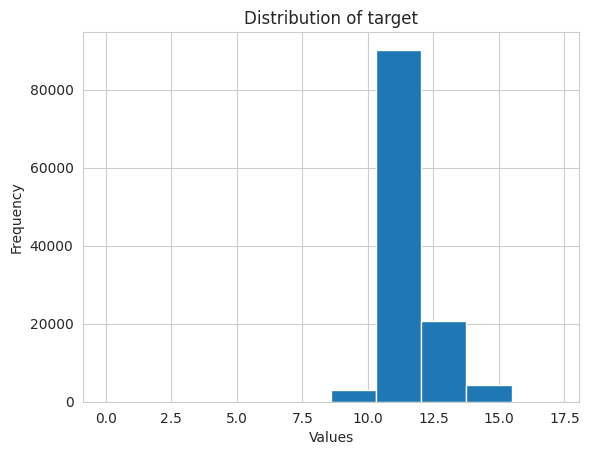

In [33]:
plt.hist(y_kiba.iloc[:, 0])

# Set the plot title and axis labels
plt.title('Distribution of target')
plt.xlabel('Values')
plt.ylabel('Frequency')

# Show the plot
plt.show()

In [34]:
X_drugs_kiba['romol'] = X_drugs_kiba[0].apply(lambda x: Chem.MolFromSmiles(x))

In [35]:
mols2grid.display(X_drugs_kiba['romol'], legends=list(y_kiba[0]))

MolGridWidget()

In [36]:
X_drugs_kiba['mol_weight'] = X_drugs_kiba['romol'].apply(lambda x: Chem.rdMolDescriptors.CalcExactMolWt(x))

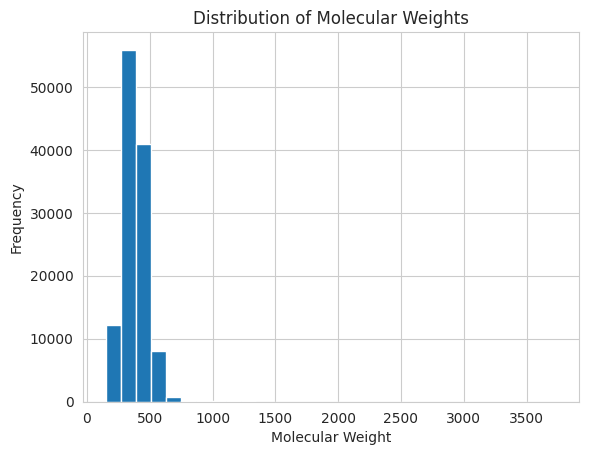

In [37]:
plt.hist(X_drugs_kiba['mol_weight'], bins=30)
plt.xlabel('Molecular Weight')
plt.ylabel('Frequency')
plt.title('Distribution of Molecular Weights')
plt.show()

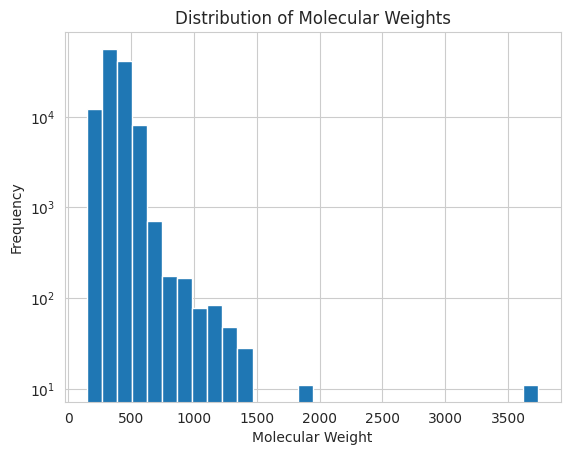

In [38]:
plt.hist(X_drugs_kiba['mol_weight'], log=True, bins=30)
plt.xlabel('Molecular Weight')
plt.ylabel('Frequency')
plt.title('Distribution of Molecular Weights')
plt.show()

The applicability domain looks similar to the one from BindingDB, so the two datasets are comparable.